# 1. Loading the Data

In [ ]:
#Mounting the google drive to access the dataset

from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
# Unzipping the data to local storage of Google colab for faster access

!unrar x "/content/gdrive/MyDrive/Capstone_project/MRI+T1_T2+Dataset.RAR"


UNRAR 5.50 freeware      Copyright (c) 1993-2017 Alexander Roshal


Extracting from /content/gdrive/MyDrive/Capstone_project/MRI+T1_T2+Dataset.RAR

Creating    Tr1                                                       OK
Extracting  Tr1/.DS_Store                                                  0%  OK 
Creating    Tr1/TrainT1                                               OK
Extracting  Tr1/TrainT1/Image #10.png                                      1%  OK 
Extracting  Tr1/TrainT1/Image #11.png                                      2%  OK 
Extracting  Tr1/TrainT1/Image #12.png                                      3%  OK 
Extracting  Tr1/TrainT1/Image #13.png                                      4%  OK 
Extracting  Tr1/TrainT1/Image #14.png                                      5%  OK 
Extracting  Tr1/TrainT1/Image #15.png                                      6%  OK 
Extracting  Tr1/TrainT1/Image #16.png                        

In [ ]:
#Importing the necessary libraries

import pathlib
import numpy as np, pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import tensorflow as tf
from skimage.transform import resize
from imageio import imread, get_writer
import glob

In [ ]:
# Storing the data path

tr1_dir = pathlib.Path("/content/Tr1")
tr2_dir = pathlib.Path("/content/Tr2")

In [ ]:
# Counting the Images in both directories

tr1_count = len(list(tr1_dir.glob("*/*.png")))
print("Tr1 images count:",tr1_count)
tr2_count = len(list(tr2_dir.glob("*/*.png")))
print("Tr2 images count:", tr2_count)

Tr1 images count: 43
Tr2 images count: 46


**`OBSERVATIONS`**:
- Count of Tr1 images and Tr2 images is different indicating **Unpaired Dataset.**



In [ ]:
# Checking if the unzipped files are present

!ls

gdrive	sample_data  Tr1  Tr2


In [ ]:
# Defining a function to load the images from the specified path

def load_images(x):
  image_list = []
  for files in x.glob("*/*.png"):
    image = imread(files)
    image_list.append(image)
  
  return np.array(image_list)

In [ ]:
# Calling the function to load both Tr1 and Tr2 images

tr1_images = load_images(tr1_dir)
tr2_images = load_images(tr2_dir)

In [ ]:
# Checking the shape of the loaded images in both Tr1 and Tr2

print("Tr1 images shape: ",tr1_images.shape)
print("Tr2 images shape: ",tr2_images.shape)

Tr1 images shape:  (43, 217, 181)
Tr2 images shape:  (46, 217, 181)


In [ ]:
# Checking 1 image data values

tr2_images[-1]

array([[3, 4, 4, ..., 3, 4, 3],
       [3, 4, 4, ..., 4, 4, 4],
       [4, 4, 4, ..., 4, 4, 4],
       ...,
       [3, 3, 1, ..., 1, 0, 0],
       [3, 3, 1, ..., 1, 0, 1],
       [3, 3, 1, ..., 1, 1, 1]], dtype=uint8)

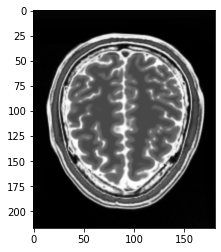

In [ ]:
# Plotting 1 image

plt.imshow(tr2_images[-1], cmap="gray")

# 2. Data Preprocessing

Performing the following steps:

1.   Data Normalization
2.   Data Resizing
3.   Data Reshaping
4.   Batch and Shuffle Data

In [ ]:
#Declaring the image dimensions and the batch_size

batch_size = 16
img_height = 256
img_width = 256

In [ ]:
# Defining a function to perform all the above mentioned data preprocessing steps

def data_processor(x):
  for image in x:
    # Normalize the image between [-1,1]
    image = (image/127.5) - 1.0

  # Resize the image
  x_new = np.zeros((x.shape[0], img_height, img_width))
  for idx, image in enumerate(x):
    x_new[idx,:,:] = resize(image, (img_height, img_width)).astype('float32')

  # Reshape the images to tensor format
  x_new = x_new.reshape(x_new.shape[0], img_height, img_width, 1).astype('float32')

  # Creating batches
  x_new = tf.data.Dataset.from_tensor_slices(x_new).shuffle(x_new.shape[0], seed=42).batch(batch_size)

  return x_new

In [ ]:
# Calling the defined function to perform the data preprocessing steps on the Tr1 and Tr2 images

tr1_data = data_processor(tr1_images)
tr2_data = data_processor(tr2_images)

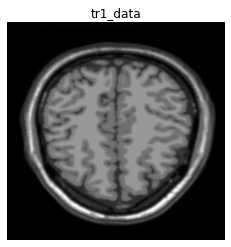

In [ ]:
# Plotting a sample Tr1 image after data processing

sample_tr1_data = next(iter(tr1_data))
plt.figure(figsize=(4,4))
plt.imshow(sample_tr1_data[0].numpy()[:, :, 0], cmap='gray')
plt.title('tr1_data')
plt.axis('off')
plt.show()

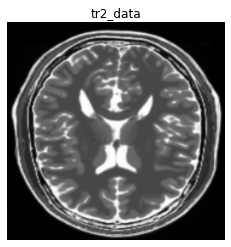

In [ ]:
# Plotting a sample Tr2 image after data processing

sample_tr2_data = next(iter(tr2_data))
plt.figure(figsize=(4,4))
plt.imshow(sample_tr2_data[0].numpy()[:, :, 0], cmap='gray')
plt.title('tr2_data')
plt.axis('off')
plt.show()

In [ ]:
# Checking the image array values of 1 image

sample_tr2_data = next(iter(tr2_data))
sample_tr2_data[0].numpy()[:, :, 0]

array([[3.9215689e-03, 3.9215689e-03, 3.9215689e-03, ..., 3.9215689e-03,
        5.6449142e-03, 7.2686886e-03],
       [3.9215689e-03, 3.9215689e-03, 3.9215689e-03, ..., 3.9215689e-03,
        5.6449142e-03, 7.2686886e-03],
       [3.9215689e-03, 3.9215689e-03, 3.9215689e-03, ..., 3.9215689e-03,
        5.6449142e-03, 7.2686886e-03],
       ...,
       [1.1764706e-02, 1.1764706e-02, 9.6660536e-03, ..., 2.1432466e-03,
        8.3721383e-04, 2.1878410e-04],
       [1.1764706e-02, 1.1764706e-02, 9.4262669e-03, ..., 3.2652162e-03,
        1.6958948e-03, 4.4317805e-04],
       [1.1764706e-02, 1.1764706e-02, 8.6966567e-03, ..., 1.2681101e-03,
        1.6744278e-04, 4.3756823e-05]], dtype=float32)

**`OBSERVATIONS`**:
- Images are resized correctly to (256,256) value.
- Images are normalized between [-1,1] and have been split into proper tensor batches which is required for model building and training.

# 3. Model Building

Performing the following steps:

1. Instance Normalization
2. Downsampling, Upsampling and Unet
3. Generator Building using Unet
4. Discriminator Building

In [ ]:
# Defining and customizing a class for Instance Normalization

class InstanceNormalization(tf.keras.layers.Layer):
    # Initialization of Objects
    def __init__(self, epsilon=1e-5):
        # calling parent's init
        super(InstanceNormalization, self).__init__()
        self.epsilon = epsilon
    
    def build(self, input_shape):
        self.scale = self.add_weight(
            name='scale',
            shape=input_shape[-1:],
            initializer=tf.random_normal_initializer(1., 0.02),
            trainable=True)
        self.offset = self.add_weight(
            name='offset',
            shape=input_shape[-1:],
            initializer='zeros',
            trainable=True)
    
    def call(self, x):
        # Compute Mean and Variance, Axes=[1,2] ensures Instance Normalization
        mean, variance = tf.nn.moments(x, axes=[1, 2], keepdims=True)
        inv = tf.math.rsqrt(variance + self.epsilon)
        normalized = (x - mean) * inv
        return self.scale * normalized + self.offset

In [ ]:
# Defining a function for downsampling layers

def downsample(filters, size, apply_norm=True):
    initializer = tf.random_normal_initializer(0., 0.02)
    result = tf.keras.Sequential()
    # Adding Conv2d layer
    result.add(tf.keras.layers.Conv2D(filters, size, strides=2, padding='same',
                                      kernel_initializer=initializer, use_bias=False))
    # Adding Normalization layer
    if apply_norm:
        result.add(InstanceNormalization())
    # Adding Leaky Relu Activation
    result.add(tf.keras.layers.LeakyReLU(alpha=0.2))
    return result

In [ ]:
# Defining a function for upsampling layers

def upsample(filters, size, apply_dropout=False):
    initializer = tf.random_normal_initializer(0., 0.02)
    result = tf.keras.Sequential()

    # Adding Transposed Conv2d layer
    result.add(tf.keras.layers.Conv2DTranspose(filters, size, strides=2, padding='same',
                                               kernel_initializer=initializer, use_bias=False))
    # Adding Normalization Layer
    result.add(InstanceNormalization())

    # Conditionally adding Dropout layer
    if apply_dropout:
        result.add(tf.keras.layers.Dropout(0.5))

    # Adding Relu Activation Layer
    result.add(tf.keras.layers.ReLU())

    return result

In [ ]:
# Defining a Unet Generator with both downsampling and upsampling layers

def unet_generator():
    down_stack = [
        downsample(64, 4, False),   # (bs, 128, 128, 64)
        downsample(64, 4),          # (bs, 64, 64, 64)
        downsample(128, 4),         # (bs, 32, 32, 128)
        downsample(128, 4),         # (bs, 16, 16, 128)
        downsample(128, 4),         # (bs, 8, 8, 128)
        downsample(256, 4),         # (bs, 4, 4, 256)
        downsample(256, 4),         # (bs, 2, 2, 256)
        downsample(512, 4)          # (bs, 1, 1, 512)
    ]
    up_stack = [
        upsample(256, 4, True),     # (bs, 2, 2, 256)
        upsample(256, 4, True),     # (bs, 4, 4, 256)
        upsample(128, 4, True),     # (bs, 8, 8, 128)
        upsample(128, 4),           # (bs, 16, 16, 128)
        upsample(128, 4),           # (bs, 32, 32, 128)
        upsample(64, 4),            # (bs, 64, 64, 64)
        upsample(64, 4)             # (bs, 128, 128, 64)
    ]
    initializer = tf.random_normal_initializer(0., 0.02)
    last = tf.keras.layers.Conv2DTranspose(1, 4, strides=2, padding='same', kernel_initializer=initializer,
                                           activation='tanh') # (bs, 256, 256, 1)
    concat = tf.keras.layers.Concatenate()
    inputs = tf.keras.layers.Input(shape=[img_height, img_width, 1])
    x = inputs

    # Downsampling through the model
    skips = []
    for down in down_stack:
        x = down(x)
        skips.append(x)
    
    skips = reversed(skips[:-1])

    # Upsampling and establishing the skip connections
    for up, skip in zip(up_stack, skips):
        x = up(x)
        x = concat([x, skip])
    x = last(x)

    return tf.keras.Model(inputs=inputs, outputs=x)

In [ ]:
# Defining the generators t1 and t2

generator_t1 = unet_generator()
generator_t2 = unet_generator()

**`NOTE:`** 
- **generator_t1** generates Tr1 images from Tr2.
- **generator_t2** generates Tr2 images from Tr1.

In [ ]:
# Checking the generator summary

generator_t1.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 256, 256, 1  0           []                               
                                )]                                                                
                                                                                                  
 sequential (Sequential)        (None, 128, 128, 64  1024        ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 sequential_1 (Sequential)      (None, 64, 64, 64)   65664       ['sequential[0][0]']             
                                                                                              

In [ ]:
# Defining the Discriminator function

def discriminator():
    initializer = tf.random_normal_initializer(0., 0.02)

    # adding input layer of size (256, 256, 1)
    inp = tf.keras.layers.Input(shape=[img_height, img_width, 1], name='input_image')
    x = inp
    
    # adding downsampling step 
    down1 = downsample(64, 4, False)(x)   # (bs, 128, 128, 64)
    down2 = downsample(128, 4)(down1)     # (bs, 64, 64, 128)
    down3 = downsample(256, 4)(down2)     # (bs, 32, 32, 128)
    down4 = downsample(256, 4)(down3)     # (bs, 16, 16, 128)
    down5 = downsample(256, 4)(down4)     # (bs, 8, 8, 256)
    down6 = downsample(256, 4)(down5)     # (bs, 4, 4, 256)

    # adding a zero padding layer
    zero_pad1 = tf.keras.layers.ZeroPadding2D()(down6) # (bs, 6, 6, 256)
    
    # implement a concrete downsampling layer with Normalization and activation
    conv = tf.keras.layers.Conv2D(512, 4, strides=1, kernel_initializer=initializer,
                                  use_bias=False)(zero_pad1) # (bs, 3, 3, 512)
    norm1 = InstanceNormalization()(conv)
    leaky_relu = tf.keras.layers.LeakyReLU(alpha=0.2)(norm1)
    
    # adding a zero padding layer
    zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu) # (bs, 5, 5, 512)
    
    # add a last pure 2D Convolution layer
    last_conv = tf.keras.layers.Conv2D(1, 4, strides=1, kernel_initializer=initializer)(zero_pad2) # (bs, 2, 2, 1)

    return tf.keras.Model(inputs=inp, outputs=last_conv)

In [ ]:
# Defining the discriminators t1 and t2

discriminator_t1 = discriminator()
discriminator_t2 = discriminator()

**`NOTE:`** 
- **discriminator_t1** discriminates Tr1 images as real/fake.
- **discriminator_t2** discriminates Tr2 images from real/fake.

In [ ]:
# Checking the discriminator summary

discriminator_t1.summary()

Model: "model_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_image (InputLayer)    [(None, 256, 256, 1)]     0         
                                                                 
 sequential_30 (Sequential)  (None, 128, 128, 64)      1024      
                                                                 
 sequential_31 (Sequential)  (None, 64, 64, 128)       131328    
                                                                 
 sequential_32 (Sequential)  (None, 32, 32, 256)       524800    
                                                                 
 sequential_33 (Sequential)  (None, 16, 16, 256)       1049088   
                                                                 
 sequential_34 (Sequential)  (None, 8, 8, 256)         1049088   
                                                                 
 sequential_35 (Sequential)  (None, 4, 4, 256)         1049

## Checking Output of Untrained Generators

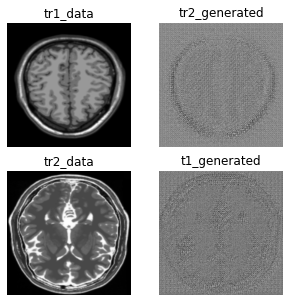

In [ ]:
t2_generated = generator_t2(sample_tr1_data)
t1_generated = generator_t1(sample_tr2_data)

plt.figure(figsize=(5,5))

imgs = [sample_tr1_data, t2_generated, sample_tr2_data, t1_generated ]
titles = ["tr1_data", "tr2_generated", "tr2_data", "t1_generated"]

for i in range(len(imgs)):
  plt.subplot(2,2,i+1)
  plt.title(titles[i])
  plt.imshow(imgs[i][0].numpy()[:,:,0], cmap="gray")
  plt.axis("off")
plt.show()

# 4. Defining Losses and Optimizers
1. Declare Loss - Binary Cross Entropy
2. Calculate Discriminator Loss
3. Calculate Generator Loss
4. Cycle Loss
5. Identity Loss
6. Optimizer

In [ ]:
# Declaring Binary Cross Entropy Loss

loss_obj = tf.keras.losses.BinaryCrossentropy(from_logits=True)

# Declaring lambda

lambda_val = 200.0

**`NOTE:`**
- After several iterations of lambda values from 10 to 250, observed lambda value of **200** to produce the best training result.

In [ ]:
# Defining Discriminator Loss

def discriminator_loss(real, generated):
  real_loss = loss_obj(tf.ones_like(real), real)
  generated_loss = loss_obj(tf.zeros_like(generated), generated)
  total_loss = real_loss + generated_loss
  return total_loss * 0.5

In [ ]:
# Defining Generator Loss

def generator_loss(generated):
  return loss_obj(tf.ones_like(generated), generated)

In [ ]:
# Defining Cycle Loss

def cycle_loss(real_img, cycled_img):
  c_loss = tf.reduce_mean(tf.abs(real_img - cycled_img))
  return c_loss * lambda_val

In [ ]:
# Defining Identity Loss

def identity_loss(real_img, same_img):
  i_loss = tf.reduce_mean(tf.abs(real_img - same_img))
  return i_loss * lambda_val * 0.5

In [ ]:
# Defining Optimizers

generator_t1_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
generator_t2_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

discriminator_t1_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_t2_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

In [ ]:
# Defining the Epochs

EPOCHS = 150

# 5. Checkpoint Initialization

In [ ]:
checkpoint_path = "./Trained_Model"

ckpt = tf.train.Checkpoint(generator_t1 = generator_t1,
                           generator_t2 = generator_t2,
                           generator_t1_optimizer = generator_t1_optimizer,
                           generator_t2_optimizer = generator_t2_optimizer,
                           discriminator_t1 = discriminator_t1,
                           discriminator_t2 = discriminator_t2,
                           discriminator_t1_optimizer = discriminator_t1_optimizer,
                           discriminator_t2_optimizer = discriminator_t2_optimizer
                           )

ckpt_manager = tf.train.CheckpointManager(ckpt, checkpoint_path, max_to_keep=3)

# restore latest checkpoint if it exists

if ckpt_manager.latest_checkpoint:
  ckpt.restore(ckpt_manager.latest_checkpoint)
  print("Sucessfully restored latest checkpoint")

## Function to display the Generated Images while Training

In [ ]:
def generate_images(model1, test_input1, model2, test_input2):
    prediction1 = model1(test_input1)
    prediction2 = model2(test_input2)
    plt.figure(figsize=(10, 5))
    display_list = [test_input1[0], prediction1[0], test_input2[0], prediction2[0]]
    title = ['Input Image', 'Predicted Image', 'Input Image', 'Predicted Image']
    for i in range(4):
        plt.subplot(1, 4, i+1)
        plt.title(title[i])
        plt.imshow(display_list[i].numpy()[:, :, 0], cmap='gray')
        plt.axis('off')

    plt.savefig('image_at_epoch_{:04d}.png'.format(epoch))
    plt.show()

# 6. TRAINING THE MODEL

### Defining a function to perform one flow of Batch Training

In [ ]:
@tf.function
def train_step(real_t1, real_t2):
  # persistent is set to True because the tape is used more than
    # once to calculate the gradients.
    with tf.GradientTape(persistent=True) as tape:
        # Generator T2 translates T1 -> T2
        # Generator T1 translates T2 -> T1

        fake_t2 = generator_t2(real_t1, training=True)
        cycled_t1 = generator_t1(fake_t2, training=True)

        fake_t1 = generator_t1(real_t2, training=True)
        cycled_t2 = generator_t2(fake_t1, training=True)

        # same_t1 and same_t2 are used for identity loss
        same_t1 = generator_t1(real_t1, training=True)
        same_t2 = generator_t2(real_t2, training=True)

        # discriminators 
        disc_real_t1 = discriminator_t1(real_t1, training=True)
        disc_real_t2 = discriminator_t2(real_t2, training=True)

        disc_fake_t1 = discriminator_t1(fake_t1, training=True)
        disc_fake_t2 = discriminator_t2(fake_t2, training=True)

        #calculating the losses
        gen_t1_loss = generator_loss(disc_fake_t1)
        gen_t2_loss = generator_loss(disc_fake_t2)

        total_cycle_loss = cycle_loss(real_t1, cycled_t1) + cycle_loss(real_t2, cycled_t2)

        # Total generator loss = BCE loss + cycle loss + identity loss
        total_gen_t1_loss = gen_t1_loss + total_cycle_loss + identity_loss(real_t1, same_t1)
        total_gen_t2_loss = gen_t2_loss + total_cycle_loss + identity_loss(real_t2, same_t2)

        # Discriminator loss
        disc_t1_loss = discriminator_loss(disc_real_t1, disc_fake_t1)
        disc_t2_loss = discriminator_loss(disc_real_t2, disc_fake_t2)

        # Calculate the gradients for generator and discriminator
        generator_t2_gradients = tape.gradient(total_gen_t2_loss, generator_t2.trainable_variables)
        generator_t1_gradients = tape.gradient(total_gen_t1_loss, generator_t1.trainable_variables)

        discriminator_t2_gradients = tape.gradient(disc_t2_loss, discriminator_t2.trainable_variables)
        discriminator_t1_gradients = tape.gradient(disc_t1_loss, discriminator_t1.trainable_variables)

        # Apply the gradients to the optimizer
        generator_t2_optimizer.apply_gradients(zip(generator_t2_gradients, generator_t2.trainable_variables))
        generator_t1_optimizer.apply_gradients(zip(generator_t1_gradients, generator_t1.trainable_variables))

        discriminator_t2_optimizer.apply_gradients(zip(discriminator_t2_gradients, discriminator_t2.trainable_variables))
        discriminator_t1_optimizer.apply_gradients(zip(discriminator_t1_gradients, discriminator_t1.trainable_variables))


### Training the CycleGAN Model for several Epochs

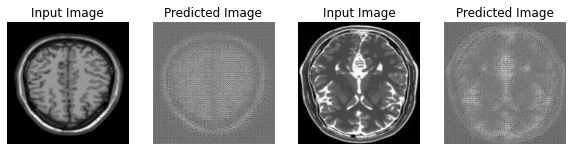

Saving checkpoint for epoch 1 at ./Trained_Model/ckpt-1


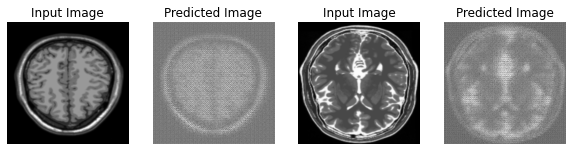

Saving checkpoint for epoch 2 at ./Trained_Model/ckpt-2


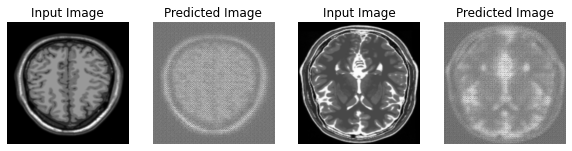

Saving checkpoint for epoch 3 at ./Trained_Model/ckpt-3


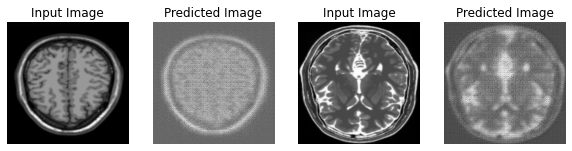

Saving checkpoint for epoch 4 at ./Trained_Model/ckpt-4


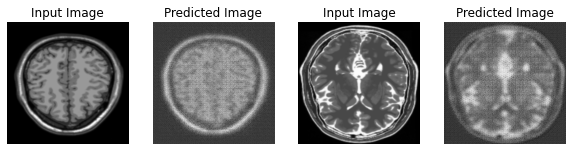

Saving checkpoint for epoch 5 at ./Trained_Model/ckpt-5


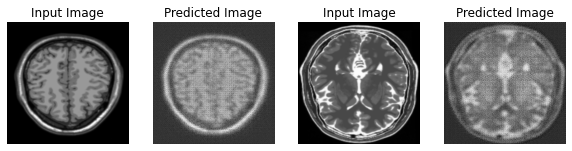

Saving checkpoint for epoch 6 at ./Trained_Model/ckpt-6


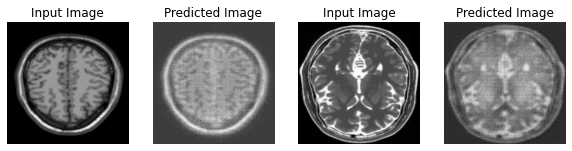

Saving checkpoint for epoch 7 at ./Trained_Model/ckpt-7


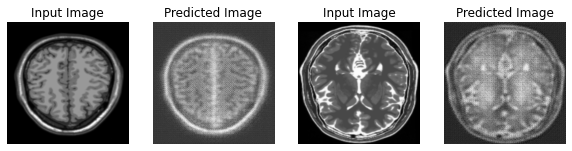

Saving checkpoint for epoch 8 at ./Trained_Model/ckpt-8


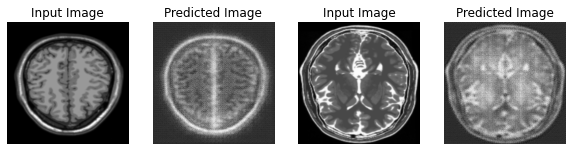

Saving checkpoint for epoch 9 at ./Trained_Model/ckpt-9


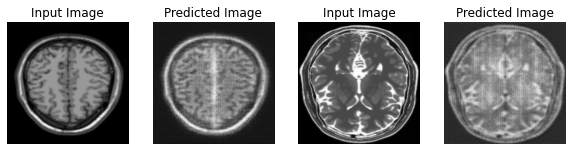

Saving checkpoint for epoch 10 at ./Trained_Model/ckpt-10


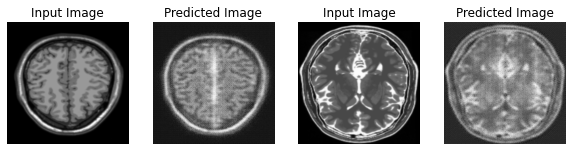

Saving checkpoint for epoch 11 at ./Trained_Model/ckpt-11


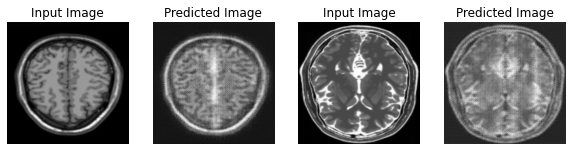

Saving checkpoint for epoch 12 at ./Trained_Model/ckpt-12


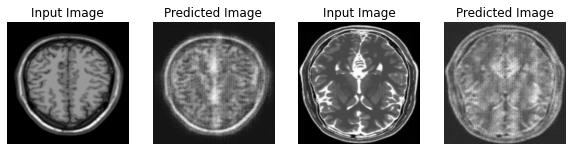

Saving checkpoint for epoch 13 at ./Trained_Model/ckpt-13


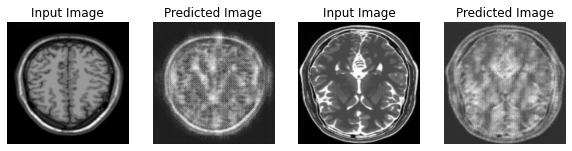

Saving checkpoint for epoch 14 at ./Trained_Model/ckpt-14


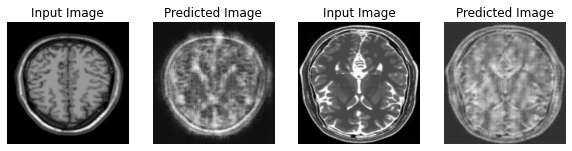

Saving checkpoint for epoch 15 at ./Trained_Model/ckpt-15


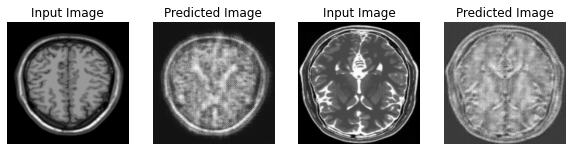

Saving checkpoint for epoch 16 at ./Trained_Model/ckpt-16


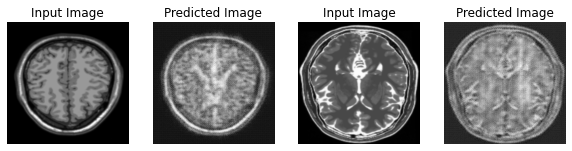

Saving checkpoint for epoch 17 at ./Trained_Model/ckpt-17


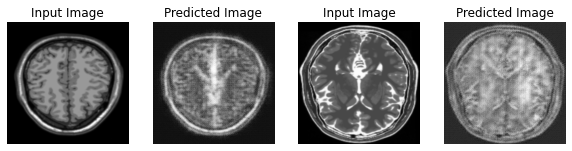

Saving checkpoint for epoch 18 at ./Trained_Model/ckpt-18


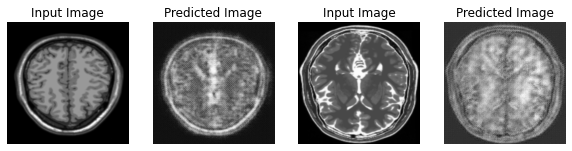

Saving checkpoint for epoch 19 at ./Trained_Model/ckpt-19


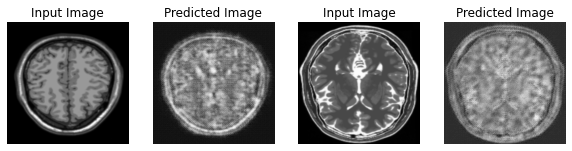

Saving checkpoint for epoch 20 at ./Trained_Model/ckpt-20


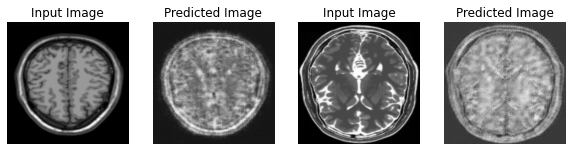

Saving checkpoint for epoch 21 at ./Trained_Model/ckpt-21


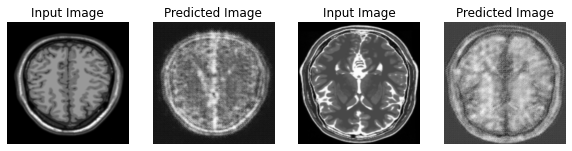

Saving checkpoint for epoch 22 at ./Trained_Model/ckpt-22


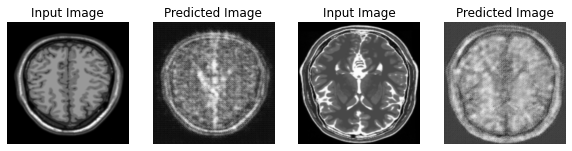

Saving checkpoint for epoch 23 at ./Trained_Model/ckpt-23


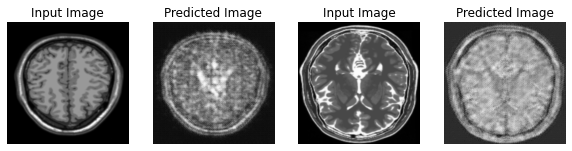

Saving checkpoint for epoch 24 at ./Trained_Model/ckpt-24


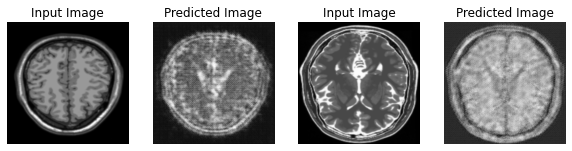

Saving checkpoint for epoch 25 at ./Trained_Model/ckpt-25


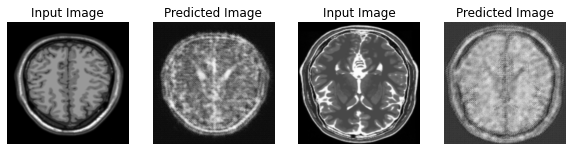

Saving checkpoint for epoch 26 at ./Trained_Model/ckpt-26


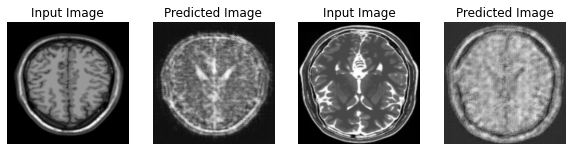

Saving checkpoint for epoch 27 at ./Trained_Model/ckpt-27


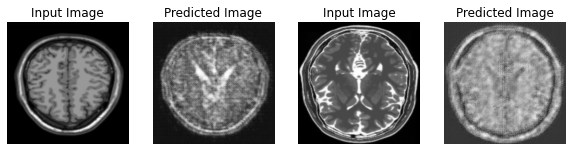

Saving checkpoint for epoch 28 at ./Trained_Model/ckpt-28


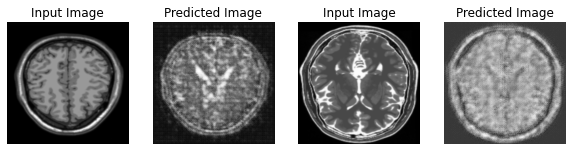

Saving checkpoint for epoch 29 at ./Trained_Model/ckpt-29


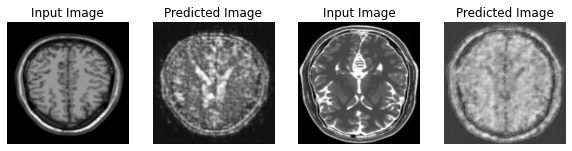

Saving checkpoint for epoch 30 at ./Trained_Model/ckpt-30


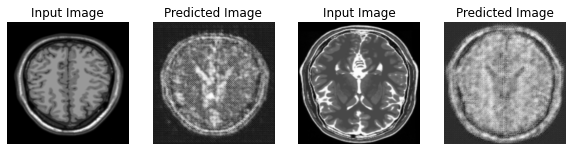

Saving checkpoint for epoch 31 at ./Trained_Model/ckpt-31


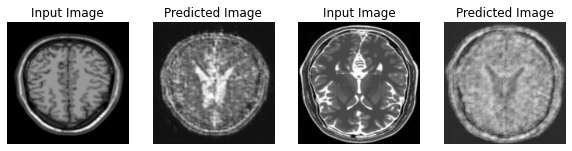

Saving checkpoint for epoch 32 at ./Trained_Model/ckpt-32


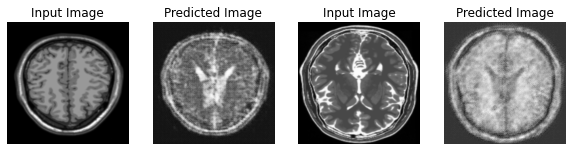

Saving checkpoint for epoch 33 at ./Trained_Model/ckpt-33


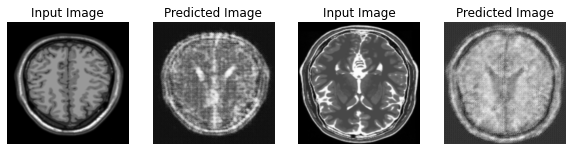

Saving checkpoint for epoch 34 at ./Trained_Model/ckpt-34


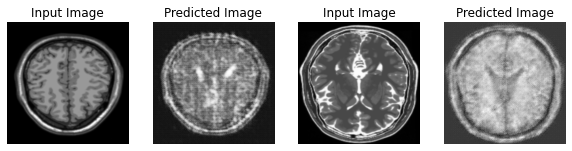

Saving checkpoint for epoch 35 at ./Trained_Model/ckpt-35


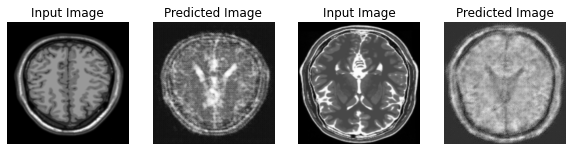

Saving checkpoint for epoch 36 at ./Trained_Model/ckpt-36


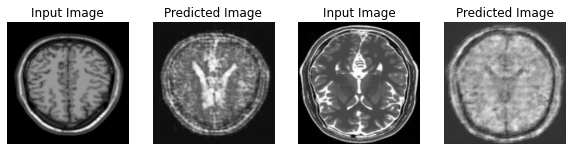

Saving checkpoint for epoch 37 at ./Trained_Model/ckpt-37


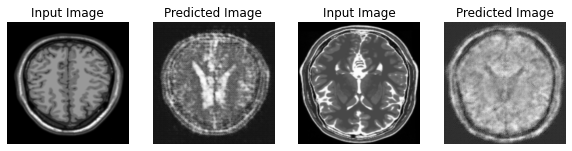

Saving checkpoint for epoch 38 at ./Trained_Model/ckpt-38


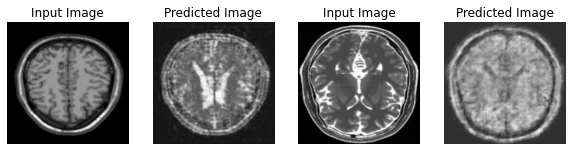

Saving checkpoint for epoch 39 at ./Trained_Model/ckpt-39


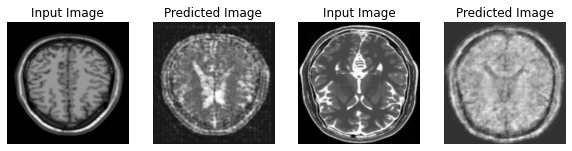

Saving checkpoint for epoch 40 at ./Trained_Model/ckpt-40


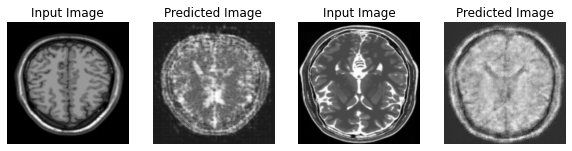

Saving checkpoint for epoch 41 at ./Trained_Model/ckpt-41


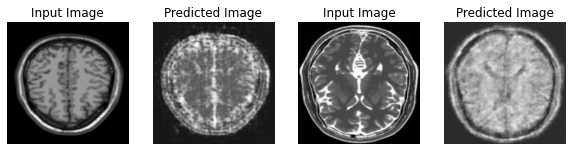

Saving checkpoint for epoch 42 at ./Trained_Model/ckpt-42


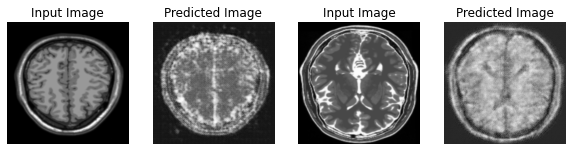

Saving checkpoint for epoch 43 at ./Trained_Model/ckpt-43


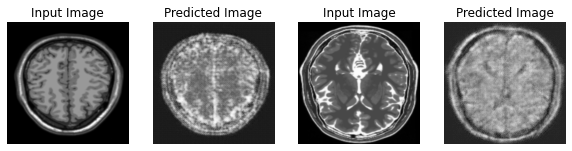

Saving checkpoint for epoch 44 at ./Trained_Model/ckpt-44


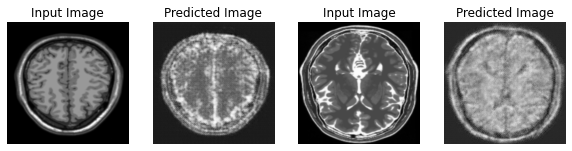

Saving checkpoint for epoch 45 at ./Trained_Model/ckpt-45


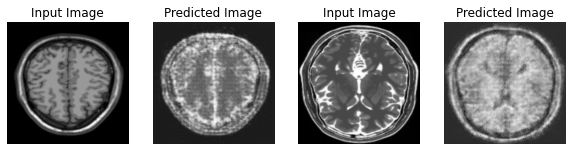

Saving checkpoint for epoch 46 at ./Trained_Model/ckpt-46


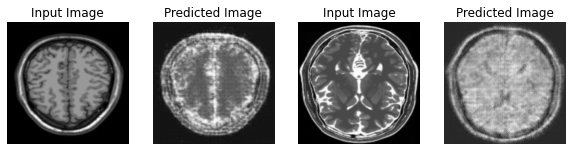

Saving checkpoint for epoch 47 at ./Trained_Model/ckpt-47


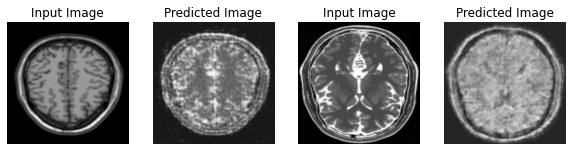

Saving checkpoint for epoch 48 at ./Trained_Model/ckpt-48


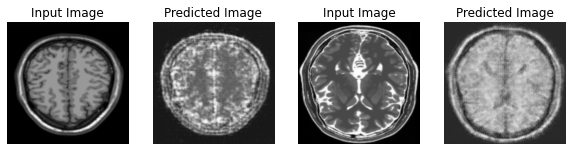

Saving checkpoint for epoch 49 at ./Trained_Model/ckpt-49


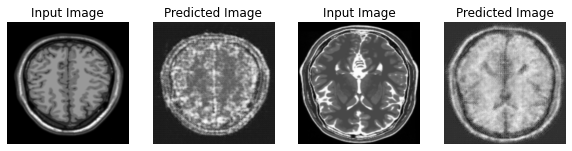

Saving checkpoint for epoch 50 at ./Trained_Model/ckpt-50


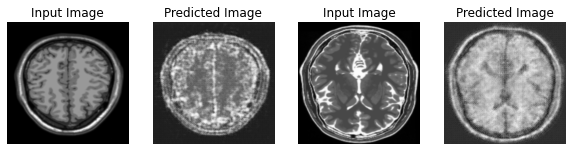

Saving checkpoint for epoch 51 at ./Trained_Model/ckpt-51


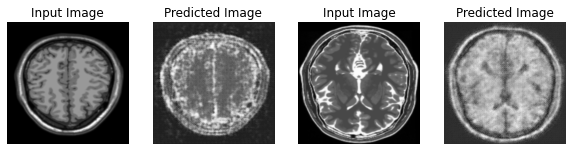

Saving checkpoint for epoch 52 at ./Trained_Model/ckpt-52


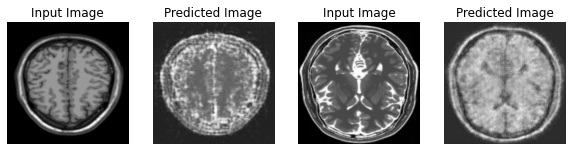

Saving checkpoint for epoch 53 at ./Trained_Model/ckpt-53


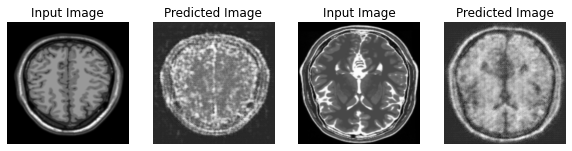

Saving checkpoint for epoch 54 at ./Trained_Model/ckpt-54


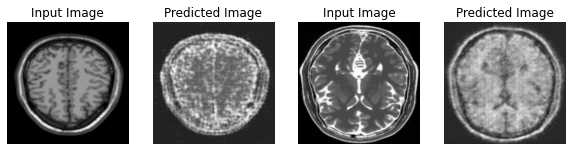

Saving checkpoint for epoch 55 at ./Trained_Model/ckpt-55


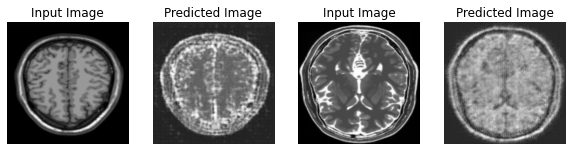

Saving checkpoint for epoch 56 at ./Trained_Model/ckpt-56


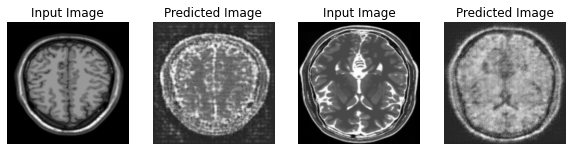

Saving checkpoint for epoch 57 at ./Trained_Model/ckpt-57


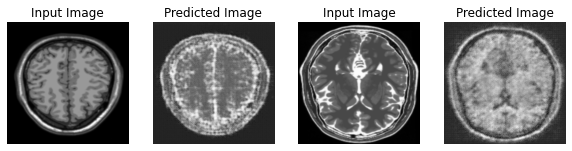

Saving checkpoint for epoch 58 at ./Trained_Model/ckpt-58


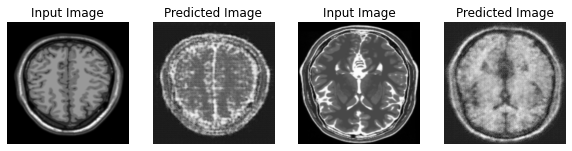

Saving checkpoint for epoch 59 at ./Trained_Model/ckpt-59


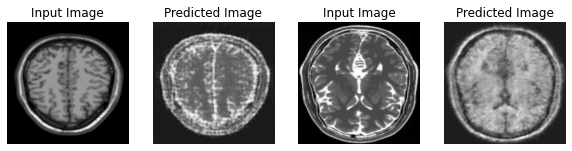

Saving checkpoint for epoch 60 at ./Trained_Model/ckpt-60


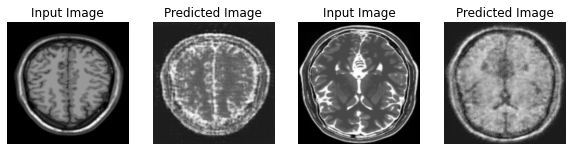

Saving checkpoint for epoch 61 at ./Trained_Model/ckpt-61


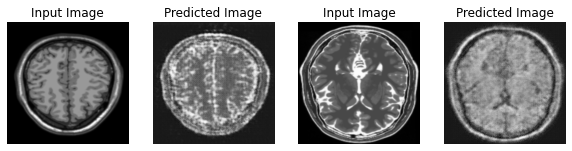

Saving checkpoint for epoch 62 at ./Trained_Model/ckpt-62


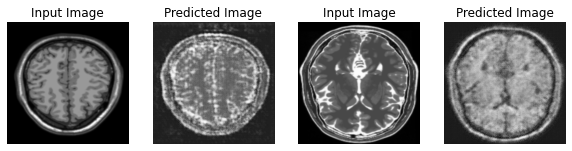

Saving checkpoint for epoch 63 at ./Trained_Model/ckpt-63


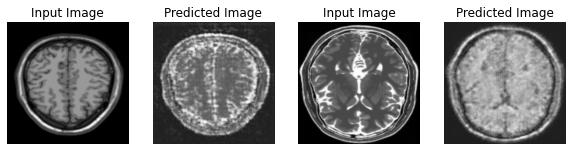

Saving checkpoint for epoch 64 at ./Trained_Model/ckpt-64


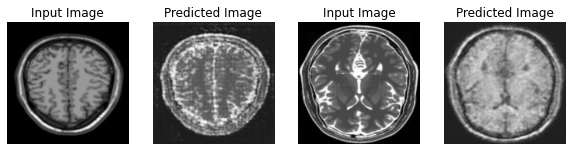

Saving checkpoint for epoch 65 at ./Trained_Model/ckpt-65


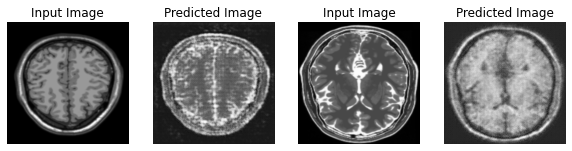

Saving checkpoint for epoch 66 at ./Trained_Model/ckpt-66


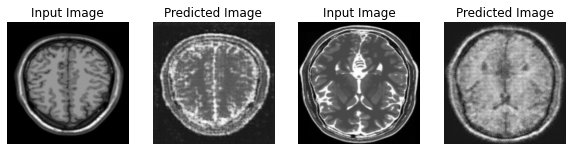

Saving checkpoint for epoch 67 at ./Trained_Model/ckpt-67


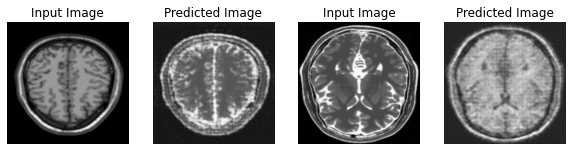

Saving checkpoint for epoch 68 at ./Trained_Model/ckpt-68


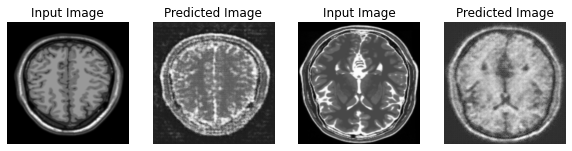

Saving checkpoint for epoch 69 at ./Trained_Model/ckpt-69


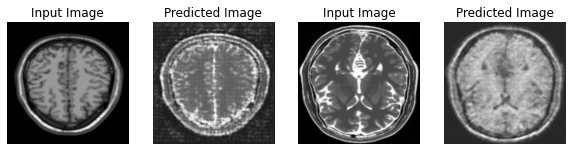

Saving checkpoint for epoch 70 at ./Trained_Model/ckpt-70


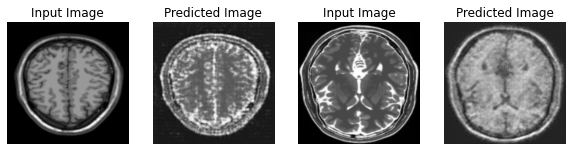

Saving checkpoint for epoch 71 at ./Trained_Model/ckpt-71


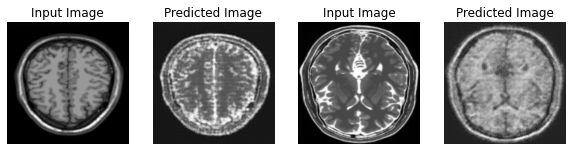

Saving checkpoint for epoch 72 at ./Trained_Model/ckpt-72


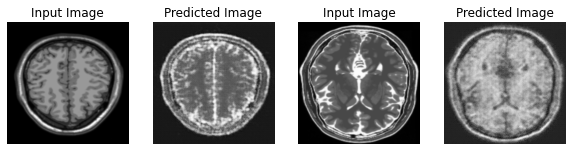

Saving checkpoint for epoch 73 at ./Trained_Model/ckpt-73


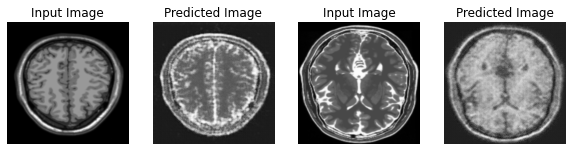

Saving checkpoint for epoch 74 at ./Trained_Model/ckpt-74


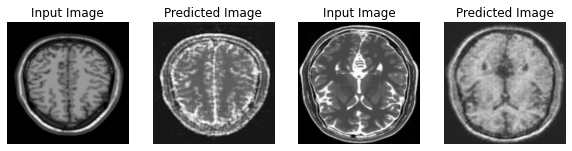

Saving checkpoint for epoch 75 at ./Trained_Model/ckpt-75


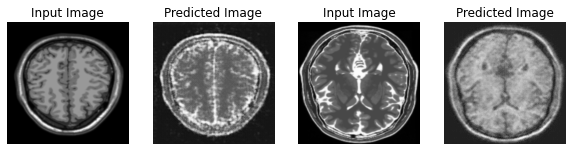

Saving checkpoint for epoch 76 at ./Trained_Model/ckpt-76


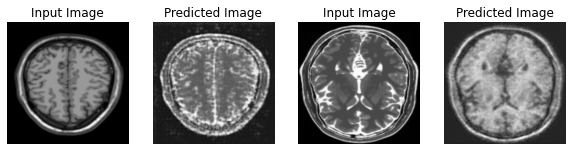

Saving checkpoint for epoch 77 at ./Trained_Model/ckpt-77


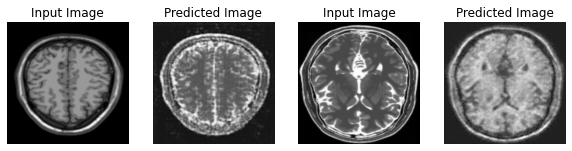

Saving checkpoint for epoch 78 at ./Trained_Model/ckpt-78


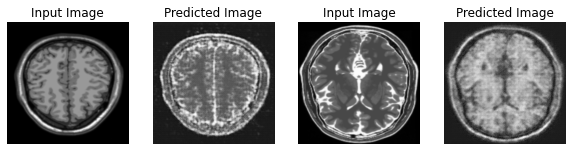

Saving checkpoint for epoch 79 at ./Trained_Model/ckpt-79


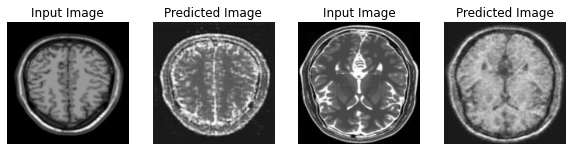

Saving checkpoint for epoch 80 at ./Trained_Model/ckpt-80


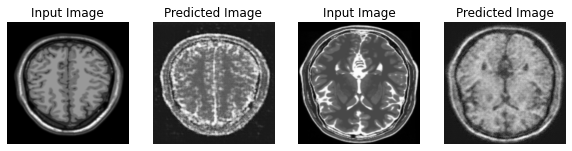

Saving checkpoint for epoch 81 at ./Trained_Model/ckpt-81


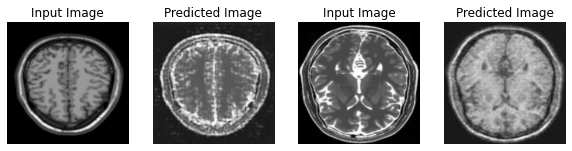

Saving checkpoint for epoch 82 at ./Trained_Model/ckpt-82


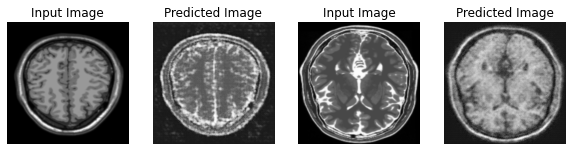

Saving checkpoint for epoch 83 at ./Trained_Model/ckpt-83


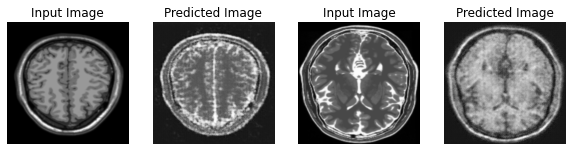

Saving checkpoint for epoch 84 at ./Trained_Model/ckpt-84


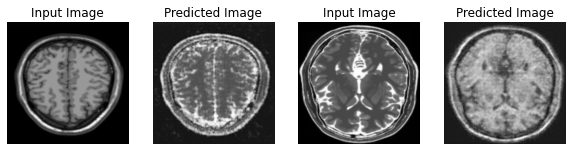

Saving checkpoint for epoch 85 at ./Trained_Model/ckpt-85


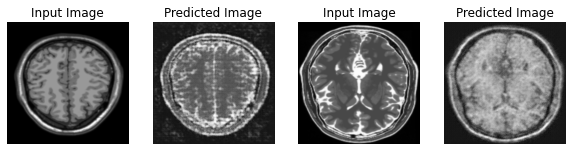

Saving checkpoint for epoch 86 at ./Trained_Model/ckpt-86


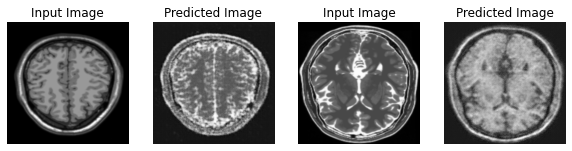

Saving checkpoint for epoch 87 at ./Trained_Model/ckpt-87


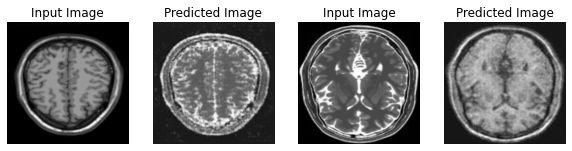

Saving checkpoint for epoch 88 at ./Trained_Model/ckpt-88


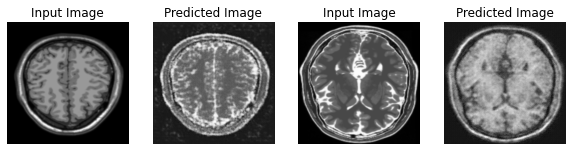

Saving checkpoint for epoch 89 at ./Trained_Model/ckpt-89


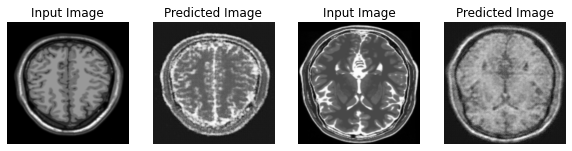

Saving checkpoint for epoch 90 at ./Trained_Model/ckpt-90


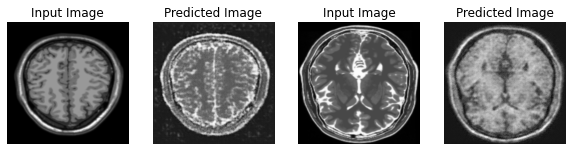

Saving checkpoint for epoch 91 at ./Trained_Model/ckpt-91


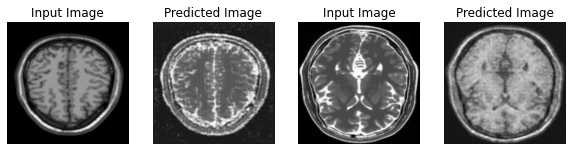

Saving checkpoint for epoch 92 at ./Trained_Model/ckpt-92


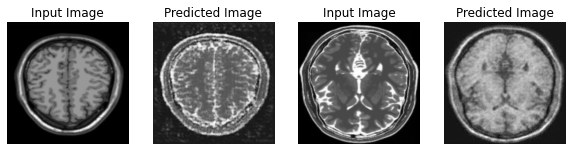

Saving checkpoint for epoch 93 at ./Trained_Model/ckpt-93


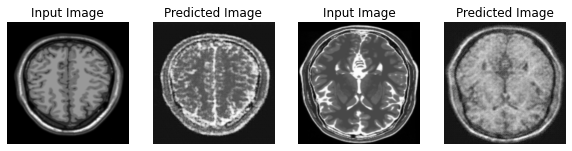

Saving checkpoint for epoch 94 at ./Trained_Model/ckpt-94


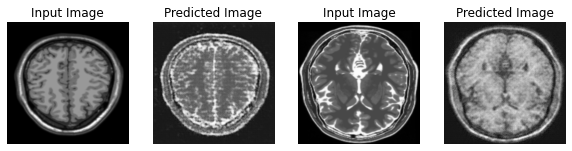

Saving checkpoint for epoch 95 at ./Trained_Model/ckpt-95


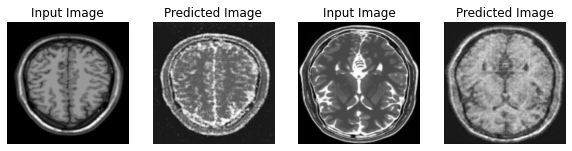

Saving checkpoint for epoch 96 at ./Trained_Model/ckpt-96


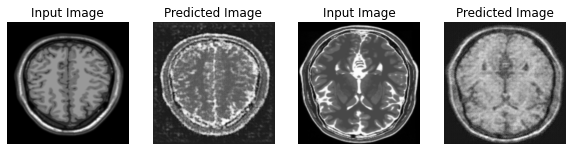

Saving checkpoint for epoch 97 at ./Trained_Model/ckpt-97


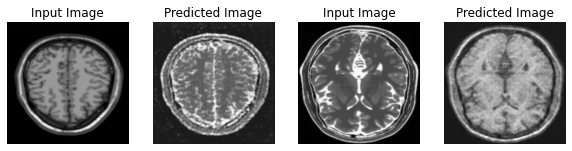

Saving checkpoint for epoch 98 at ./Trained_Model/ckpt-98


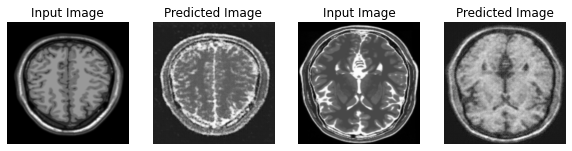

Saving checkpoint for epoch 99 at ./Trained_Model/ckpt-99


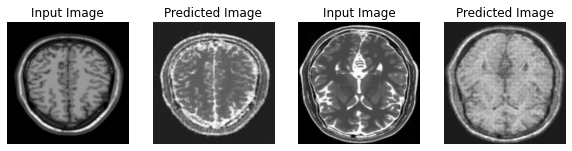

Saving checkpoint for epoch 100 at ./Trained_Model/ckpt-100


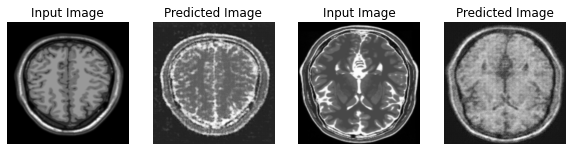

Saving checkpoint for epoch 101 at ./Trained_Model/ckpt-101


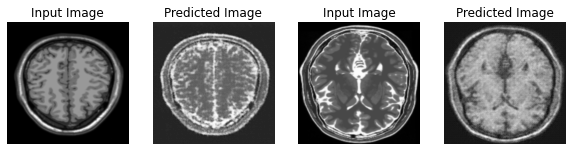

Saving checkpoint for epoch 102 at ./Trained_Model/ckpt-102


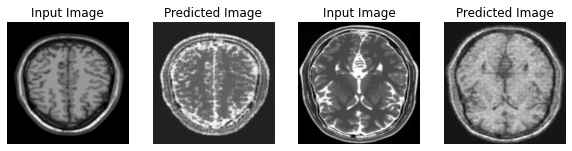

Saving checkpoint for epoch 103 at ./Trained_Model/ckpt-103


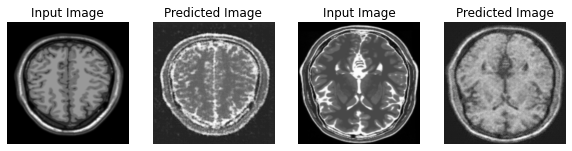

Saving checkpoint for epoch 104 at ./Trained_Model/ckpt-104


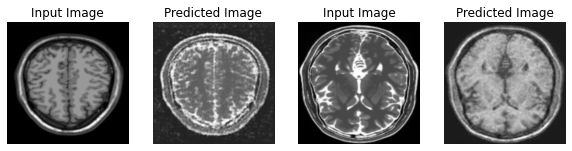

Saving checkpoint for epoch 105 at ./Trained_Model/ckpt-105


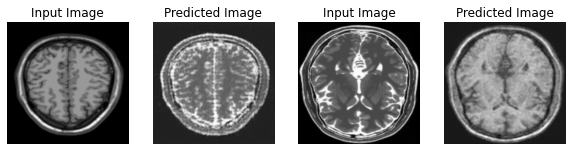

Saving checkpoint for epoch 106 at ./Trained_Model/ckpt-106


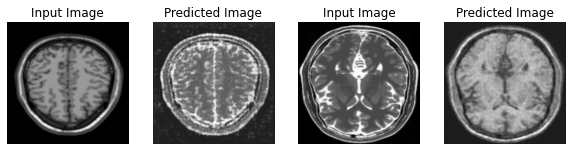

Saving checkpoint for epoch 107 at ./Trained_Model/ckpt-107


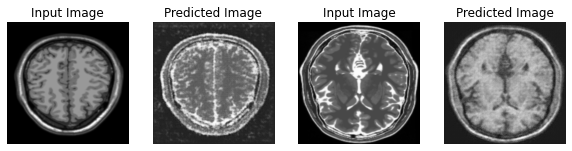

Saving checkpoint for epoch 108 at ./Trained_Model/ckpt-108


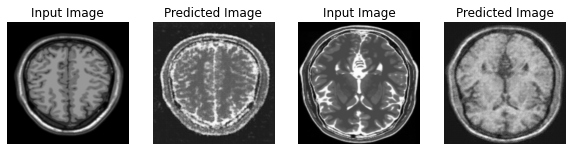

Saving checkpoint for epoch 109 at ./Trained_Model/ckpt-109


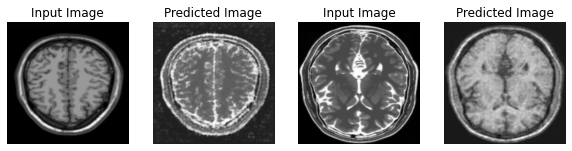

Saving checkpoint for epoch 110 at ./Trained_Model/ckpt-110


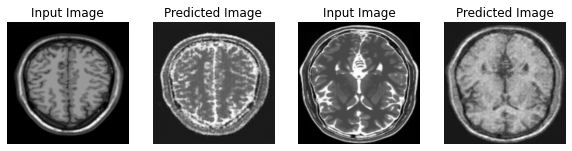

Saving checkpoint for epoch 111 at ./Trained_Model/ckpt-111


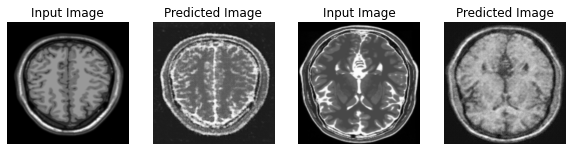

Saving checkpoint for epoch 112 at ./Trained_Model/ckpt-112


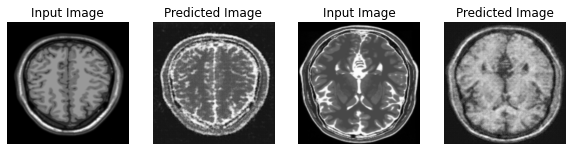

Saving checkpoint for epoch 113 at ./Trained_Model/ckpt-113


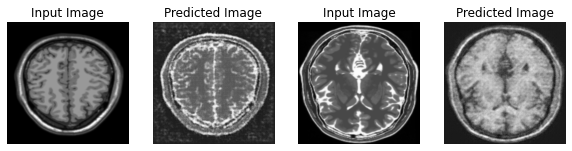

Saving checkpoint for epoch 114 at ./Trained_Model/ckpt-114


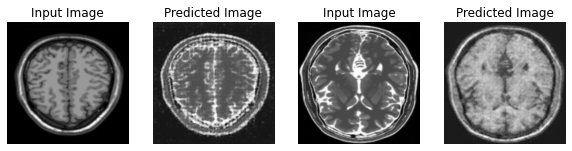

Saving checkpoint for epoch 115 at ./Trained_Model/ckpt-115


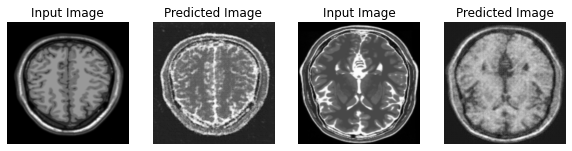

Saving checkpoint for epoch 116 at ./Trained_Model/ckpt-116


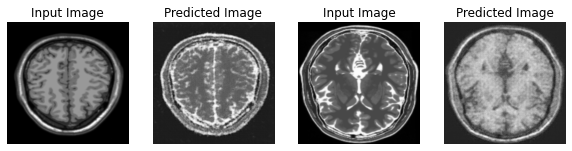

Saving checkpoint for epoch 117 at ./Trained_Model/ckpt-117


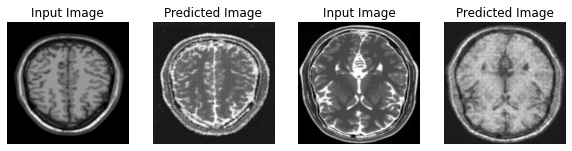

Saving checkpoint for epoch 118 at ./Trained_Model/ckpt-118


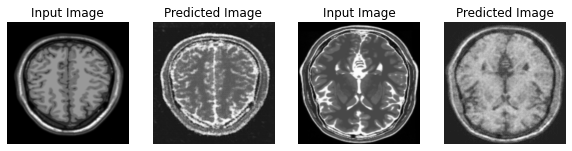

Saving checkpoint for epoch 119 at ./Trained_Model/ckpt-119


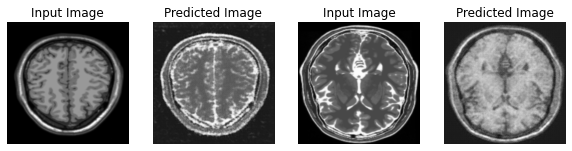

Saving checkpoint for epoch 120 at ./Trained_Model/ckpt-120


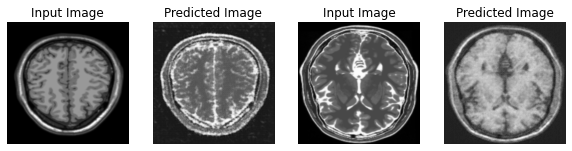

Saving checkpoint for epoch 121 at ./Trained_Model/ckpt-121


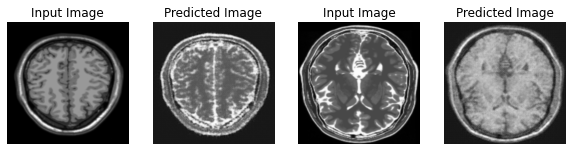

Saving checkpoint for epoch 122 at ./Trained_Model/ckpt-122


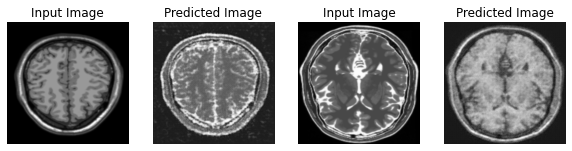

Saving checkpoint for epoch 123 at ./Trained_Model/ckpt-123


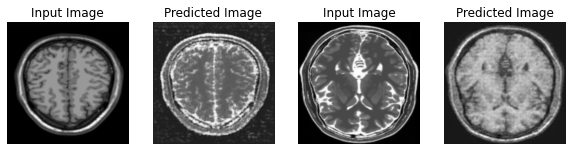

Saving checkpoint for epoch 124 at ./Trained_Model/ckpt-124


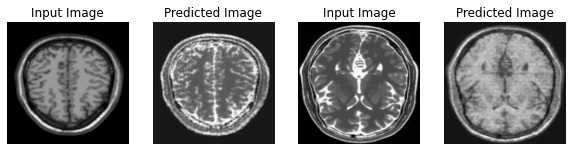

Saving checkpoint for epoch 125 at ./Trained_Model/ckpt-125


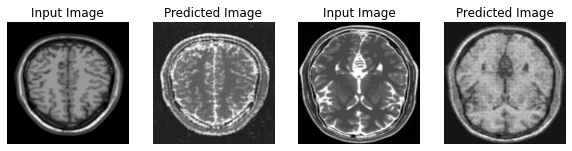

Saving checkpoint for epoch 126 at ./Trained_Model/ckpt-126


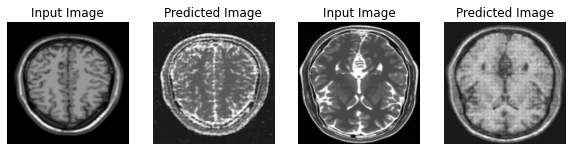

Saving checkpoint for epoch 127 at ./Trained_Model/ckpt-127


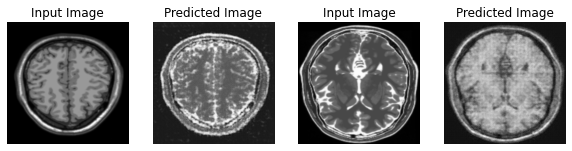

Saving checkpoint for epoch 128 at ./Trained_Model/ckpt-128


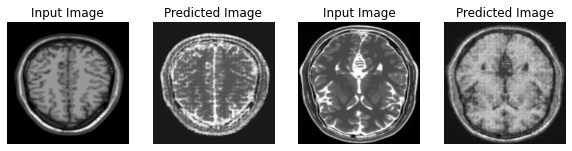

Saving checkpoint for epoch 129 at ./Trained_Model/ckpt-129


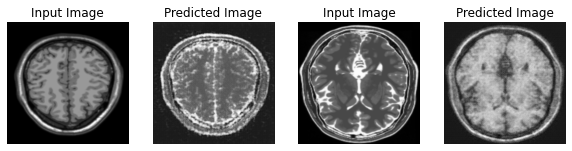

Saving checkpoint for epoch 130 at ./Trained_Model/ckpt-130


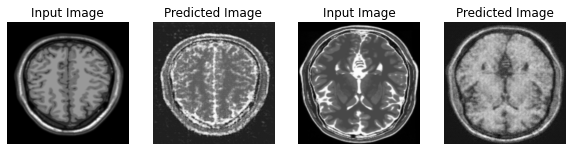

Saving checkpoint for epoch 131 at ./Trained_Model/ckpt-131


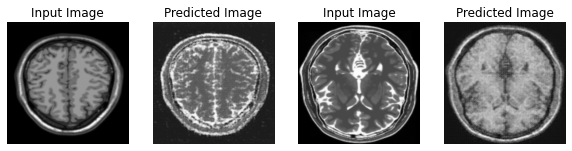

Saving checkpoint for epoch 132 at ./Trained_Model/ckpt-132


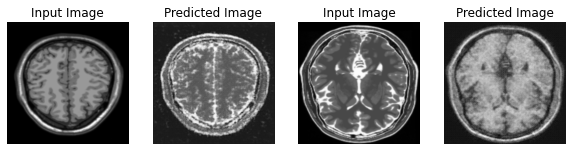

Saving checkpoint for epoch 133 at ./Trained_Model/ckpt-133


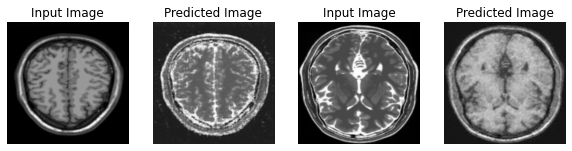

Saving checkpoint for epoch 134 at ./Trained_Model/ckpt-134


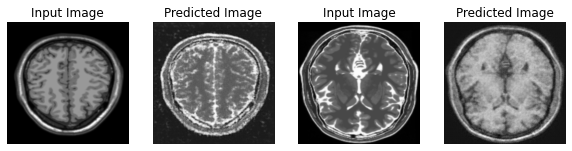

Saving checkpoint for epoch 135 at ./Trained_Model/ckpt-135


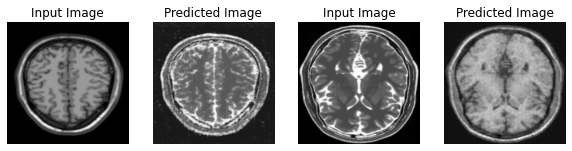

Saving checkpoint for epoch 136 at ./Trained_Model/ckpt-136


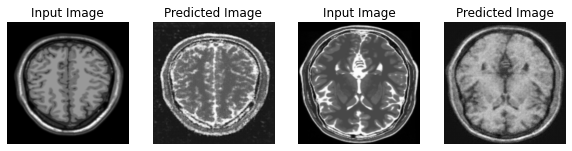

Saving checkpoint for epoch 137 at ./Trained_Model/ckpt-137


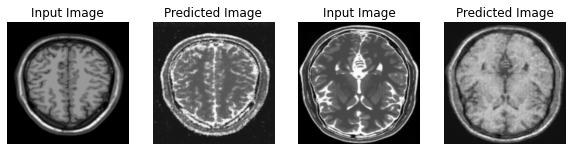

Saving checkpoint for epoch 138 at ./Trained_Model/ckpt-138


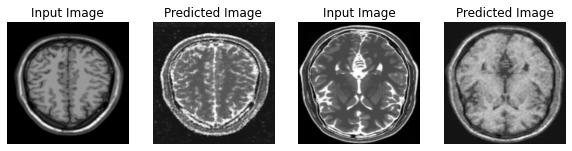

Saving checkpoint for epoch 139 at ./Trained_Model/ckpt-139


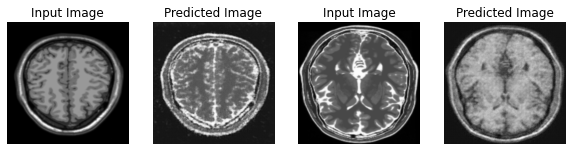

Saving checkpoint for epoch 140 at ./Trained_Model/ckpt-140


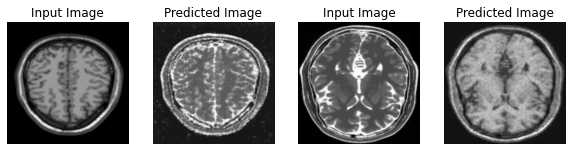

Saving checkpoint for epoch 141 at ./Trained_Model/ckpt-141


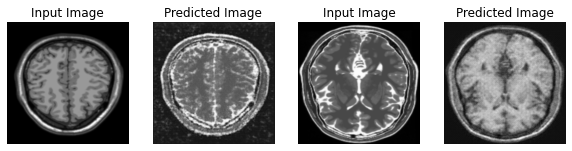

Saving checkpoint for epoch 142 at ./Trained_Model/ckpt-142


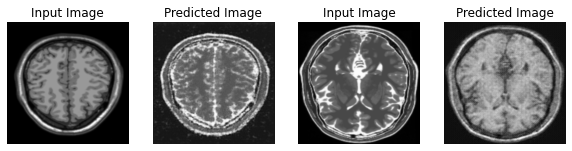

Saving checkpoint for epoch 143 at ./Trained_Model/ckpt-143


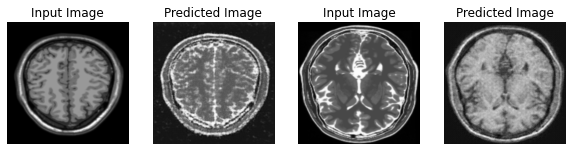

Saving checkpoint for epoch 144 at ./Trained_Model/ckpt-144


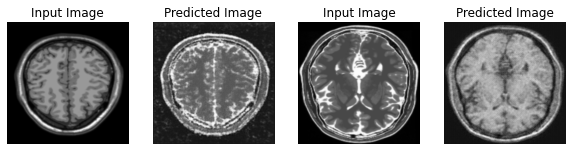

Saving checkpoint for epoch 145 at ./Trained_Model/ckpt-145


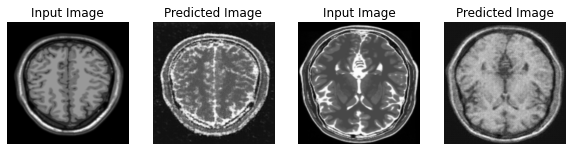

Saving checkpoint for epoch 146 at ./Trained_Model/ckpt-146


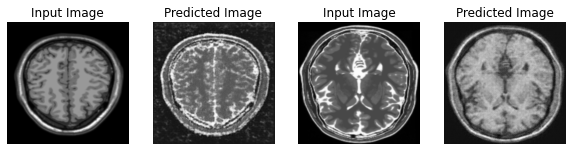

Saving checkpoint for epoch 147 at ./Trained_Model/ckpt-147


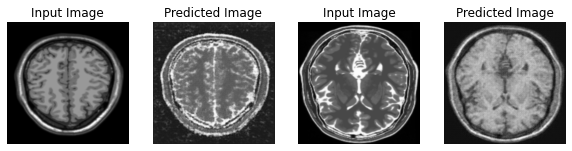

Saving checkpoint for epoch 148 at ./Trained_Model/ckpt-148


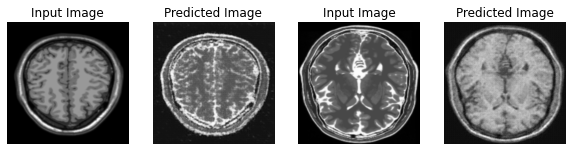

Saving checkpoint for epoch 149 at ./Trained_Model/ckpt-149


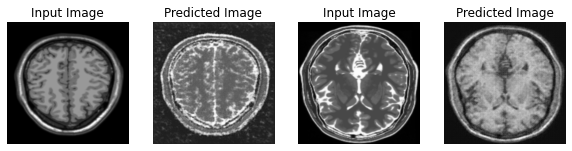

Saving checkpoint for epoch 150 at ./Trained_Model/ckpt-150


In [ ]:
for epoch in range(1, EPOCHS+1):
  for image_t1, image_t2 in tf.data.Dataset.zip((tr1_data, tr2_data)):
    train_step(image_t1, image_t2)
  generate_images(generator_t2, sample_tr1_data, generator_t1, sample_tr2_data)
  ckpt_save_path = ckpt_manager.save()
  print('Saving checkpoint for epoch', epoch, 'at', ckpt_save_path)

**`OBSERVATIONS:`**
- A good translation of **Tr1 images to Tr2 images** and **Tr2 images to Tr1 images** have started around 130 epoch.


# 7. GIF Generation
- Generating a GIF for visualization of the trained images


In [ ]:
# Putting all the generated images into one place

anim_file = 'mri.gif'

with get_writer(anim_file, mode='I') as writer:
  filenames = glob.glob('image*.png')
  filenames = sorted(filenames)
  for filename in filenames:
    image = imread(filename)
    writer.append_data(image)
  image = imread(filename)
  writer.append_data(image)

In [ ]:
pip install git+https://github.com/tensorflow/docs

  Cloning https://github.com/tensorflow/docs to /tmp/pip-req-build-je0cnny_
  Running command git clone -q https://github.com/tensorflow/docs /tmp/pip-req-build-je0cnny_
  Created wheel for tensorflow-docs: filename=tensorflow_docs-0.0.0.dev0-py3-none-any.whl size=173744 sha256=dcc1cb50f6a4af91ef5f416340c7de050c37f3b110ebd64f35ebb87f02fd8e64
  Stored in directory: /tmp/pip-ephem-wheel-cache-_yhl_dpf/wheels/cc/c4/d8/5341e93b6376c5c929c49469fce21155eb69cef1a4da4ce32c
Successfully built tensorflow-docs



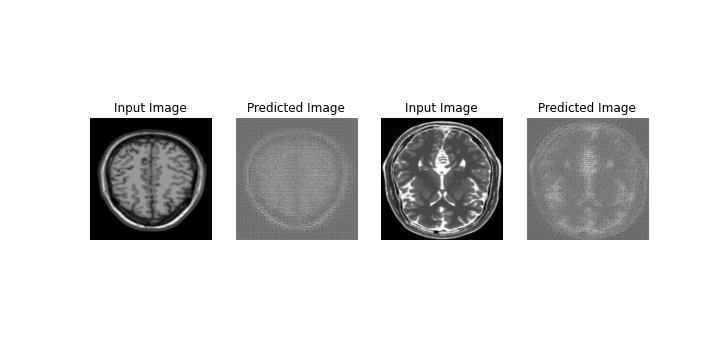

In [ ]:
# Importing Plotting the GIF 

import tensorflow_docs.vis.embed as embed
embed.embed_file(anim_file)